In [1]:
import pandas as pd #abc
import numpy as np
import random as rd
import matplotlib.pyplot as plt 
%matplotlib inline
import seaborn as sns

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline

import warnings 
warnings.filterwarnings('ignore') 

# 一、读入数据

In [2]:
data = pd.read_csv('2016.csv')
data.head()

,Date,"М1, t","М2, t","ΔМ, t","Т1, °C","Т2, °C","ΔТ, °C","Q, Gcal",USPD,YYYYMM,registrated,scheme,type,area,floors,walls material,year of construction,area of building,"temp,˚C"
0,2016/1/1,102.51,92.05,10.46,81.99,53.36,28.63,2.94,1,201601,Heating + Hot water,opened,1105,2707.4,5,panel,1983,4401.0,-17.782121
1,2016/1/1,124.86,125.29,-0.43,82.58,50.24,32.34,4.05,3,201601,Heating + Hot water,closed,2105,3358.4,5,brick,1974,3610.4,-17.782121
2,2016/1/1,127.31,128.51,-1.20,83.26,51.72,31.55,4.02,4,201601,Heating + Hot water,closed,2105,3153.5,5,brick,1975,3150.2,-17.782121
3,2016/1/1,86.36,81.61,4.75,92.55,54.82,37.73,3.26,10,201601,Heating + Hot water,opened,1105,2646.5,5,panel,1982,2932.7,-17.782121
4,2016/1/1,170.81,168.74,2.07,83.29,59.70,23.59,4.04,12,201601,Heating + Hot water,closed,2105,3187.5,5,brick,1976,3456.2,-17.782121


In [3]:
data = data.rename(columns={'temp,˚C': 'temp','Q, Gcal':'Q', 'М1, t':'M1', 'М2, t':'M2', 'Т1, °C':'T1', 'Т2, °C':'T2', 'ΔМ, t':'delta_M', 'ΔТ, °C':'delta_T'})
#data['Date'] = pd.to_datetime(data['Date'])
data

,Date,M1,M2,delta_M,T1,T2,delta_T,Q,USPD,YYYYMM,registrated,scheme,type,area,floors,walls material,year of construction,area of building,temp
0,2016/1/1,102.51,92.05,10.46,81.99,53.36,28.63,2.94,1,201601,Heating + Hot water,opened,1105,2707.4,5,panel,1983,4401.00,-17.782121
1,2016/1/1,124.86,125.29,-0.43,82.58,50.24,32.34,4.05,3,201601,Heating + Hot water,closed,2105,3358.4,5,brick,1974,3610.40,-17.782121
2,2016/1/1,127.31,128.51,-1.20,83.26,51.72,31.55,4.02,4,201601,Heating + Hot water,closed,2105,3153.5,5,brick,1975,3150.20,-17.782121
3,2016/1/1,86.36,81.61,4.75,92.55,54.82,37.73,3.26,10,201601,Heating + Hot water,opened,1105,2646.5,5,panel,1982,2932.70,-17.782121
4,2016/1/1,170.81,168.74,2.07,83.29,59.70,23.59,4.04,12,201601,Heating + Hot water,closed,2105,3187.5,5,brick,1976,3456.20,-17.782121
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
164787,2016/12/31,102.46,86.99,15.47,77.50,52.95,24.55,2.51,3150,201612,Heating + Hot water,opened,1109,1886.0,9,panel,1979,13548.30,-8.144842
164788,2016/12/31,79.47,71.58,7.89,77.56,48.82,28.74,2.29,3151,201612,Heating + Hot water,opened,1105,2139.1,5,panel,1964,4262.06,-8.144842
164789,2016/12/31,274.49,272.79,1.69,77.89,49.34,28.55,7.86,3152,201612,Heating + Hot water,closed,2110,6609.2,10,panel,1999,12626.10,-8.144842
164790,2016/12/31,436.13,437.33,-1.20,66.52,49.35,17.17,7.50,3153,201612,Heating + Hot water,closed,2105,6447.4,5,brick,1988,7249.70,-8.144842


In [4]:
import datetime
from datetime import datetime

data_temp_date = data.groupby("Date").temp.mean()
data_Q_date = data.groupby("Date").Q.mean()
merged_temp_Q = pd.merge(data_temp_date, data_Q_date, on='Date')
merged_temp_Q['Date'] = merged_temp_Q.index
merged_temp_Q['Date'] = pd.to_datetime(merged_temp_Q['Date'])

merged_temp_Q = merged_temp_Q.reset_index(drop=True)
merged_temp_Q = merged_temp_Q.sort_values(['Date'])

merged_temp_Q['Date']= merged_temp_Q['Date'].apply(lambda x: datetime.strftime(x,'%Y-%m-%d'))
merged_temp_Q.describe()


,temp,Q
count,220.000000,220.000000
mean,-6.771093,3.302338
std,10.036346,0.864934
min,-32.582617,0.793787
25%,-13.290211,2.569404
50%,-6.160375,3.225212
75%,0.584797,3.951401
max,16.963864,5.137470


<Figure size 432x288 with 0 Axes>

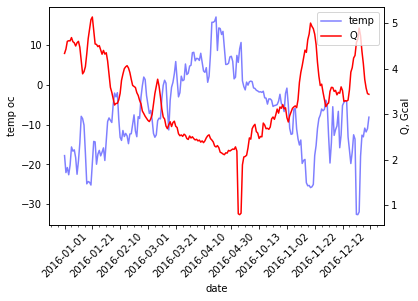

In [5]:
# 将返回既是fig图形对象又axes是2x1的轴对象数组,也就是两行一列的两个子图
# 和以下三句等同
from matplotlib.ticker import MultipleLocator, FormatStrFormatter 


fig=plt.figure()

Date_2016 = merged_temp_Q['Date']
Temp_2016 = merged_temp_Q['temp']
Q_2016 = merged_temp_Q['Q']
# axs[0]表示第一个图
#plt.plot(merged_temp_Q['Date'], merged_temp_Q['Q'], merged_temp_Q['Date'], merged_temp_Q['temp'])
# grid(true)绘制刻度线的网格 False不绘制
#plt.grid(False)
# axs[1]表示第二个图 dt为步长
# 绘制s1和s2相关性函数，NNFT=256应该是默认参数
#cxy, f = axs[1].cohere(merged_temp_Q['Q'], merged_temp_Q['temp'], 256, 1. / dt)
fig, ax1 = plt.subplots()
plt.xticks(rotation=45)
ax1.plot(Date_2016, Temp_2016, color="blue", alpha=0.5, label="temp")
ax1.set_xlabel("date")
ax1.set_ylabel("temp oc")


ax2 = ax1.twinx()
ax2.plot(Date_2016, Q_2016, color="red", label="Q")
ax2.set_ylabel("Q, Gcal")

fig.legend(loc="upper right", bbox_to_anchor=(1, 1), bbox_transform=ax1.transAxes)


xmajorLocator  = MultipleLocator(20) #将x主刻度标签设置为20的倍数 
xminorLocator  = MultipleLocator(5) #将x轴次刻度标签设置为5的倍数 
ymajorLocator  = MultipleLocator(0.5) #将y轴主刻度标签设置为0.5的倍数 
yminorLocator  = MultipleLocator(0.1) #将此y轴次刻度标签设置为0.1的倍数 

#设置主刻度标签的位置,标签文本的格式 
ax1.xaxis.set_major_locator(xmajorLocator) 
#显示次刻度标签的位置,没有标签文本 
ax1.xaxis.set_minor_locator(xminorLocator) 
#tight_layout会自动调整子图参数，使之填充适应整个图像区域


plt.show( )

## 1. 查看目标值分布

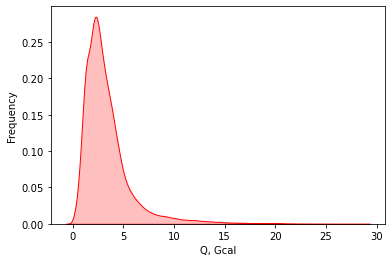

In [6]:
Q_Gcal = data[['Q']]

h = sns.kdeplot(Q_Gcal.Q, color="Red", shade = True)
h.set_xlabel("Q, Gcal")
h.set_ylabel("Frequency")
plt.show()

当数据呈现长尾分布时，会导致分类器出现bias(势利眼)，分类器更偏向于识别样本量充足，类内多样性丰富的头部类，从而忽略了尾部类，这对尾部类而言是不公平的。由于尾部ID的数量庞大，而且每个尾部ID所拥有的样本数量稀少，这会导致特征空间十分混乱，大量类别的辨识度不高，使得特征空间发生扭曲，畸变。最终网络学习得到的是一个不健康的模型，先天畸形

## 二、 进行数据分箱:连续值变为离散值，回归任务变为分类任务

In [7]:
import autoBinning
from autoBinning.utils.forwardSplit import *
# sby='woeiv'时考虑woe趋势，sby='iv'时不考虑woe趋势
t = forwardSplit(data['Q'], data['Q'])
t.fit(sby='iv',minv=0.1,init_split=6)
print(t.bins) 
t = forwardSplit(data['Q'], data['Q'])
t.fit(sby='iv',num_split=6,init_split=6)
print(t.bins) 
t.fit(sby='woeiv',num_split=6,init_split=6)
print(t.bins)

print("bin\twoe")
for i in range(len(t.bins)-1):
    v = t.value[(t.x < t.bins[i+1]) & (t.x >= t.bins[i])]
    woe = t._cal_woe(v)
    print((t.bins[i], t.bins[i+1]),woe)

None
[1.000e-02 1.520e+00 2.170e+00 2.867e+01]
[1.000e-02 1.520e+00 2.170e+00 2.760e+00 3.540e+00 4.770e+00 2.867e+01]
bin	woe
(0.01, 1.52) 1.8066973640756427
(1.52, 2.17) 0
(2.17, 2.76) 0
(2.76, 3.54) 0
(3.54, 4.77) 0
(4.77, 28.67) 0


In [8]:
from pandas import Series, DataFrame
bins=[0,5,10,15,20,25,30]
bin_data = pd.cut(data['Q'], bins)
print(pd.value_counts(bin_data))

(0, 5]      140216
(5, 10]      19612
(10, 15]      3695
(15, 20]      1017
(20, 25]       242
(25, 30]        10
Name: Q, dtype: int64


In [9]:
def func(x):
    if ((x<5) & (x>0)):
        return "1"
    elif ((x>=5) & (x<10)):
        return "2"
    elif ((x>=10) & (x<15)):
        return "3"
    elif ((x>=15) & (x<20)):  
        return "4"
    elif ((x>=20) & (x<25)):  
        return "5"
    elif ((x>=25) & (x<30)):
        return "6"
    elif (x>=30):
        return "7"
    else:
        return 'N/A'
data['level'] = data['Q'].apply(func)
data.head(10)

,Date,M1,M2,delta_M,T1,T2,delta_T,Q,USPD,YYYYMM,registrated,scheme,type,area,floors,walls material,year of construction,area of building,temp,level
0,2016/1/1,102.51,92.05,10.46,81.99,53.36,28.63,2.94,1,201601,Heating + Hot water,opened,1105,2707.40,5,panel,1983,4401.00,-17.782121,1
1,2016/1/1,124.86,125.29,-0.43,82.58,50.24,32.34,4.05,3,201601,Heating + Hot water,closed,2105,3358.40,5,brick,1974,3610.40,-17.782121,1
2,2016/1/1,127.31,128.51,-1.20,83.26,51.72,31.55,4.02,4,201601,Heating + Hot water,closed,2105,3153.50,5,brick,1975,3150.20,-17.782121,1
3,2016/1/1,86.36,81.61,4.75,92.55,54.82,37.73,3.26,10,201601,Heating + Hot water,opened,1105,2646.50,5,panel,1982,2932.70,-17.782121,1
4,2016/1/1,170.81,168.74,2.07,83.29,59.70,23.59,4.04,12,201601,Heating + Hot water,closed,2105,3187.50,5,brick,1976,3456.20,-17.782121,1
5,2016/1/1,1004.90,982.48,22.42,76.07,55.98,20.09,20.23,13,201601,Heating,closed,2009,18801.10,9,panel,1988,21000.00,-17.782121,5
6,2016/1/1,120.56,105.68,14.87,80.64,51.62,29.01,3.50,14,201601,Heating + Hot water,opened,1105,3604.55,5,panel,1968,4779.29,-17.782121,1
7,2016/1/1,98.13,88.30,9.82,82.99,49.18,33.80,3.32,17,201601,Heating + Hot water,opened,1105,3234.45,5,brick,1965,4319.65,-17.782121,1
8,2016/1/1,97.25,80.42,16.83,84.09,52.14,31.96,3.11,18,201601,Heating + Hot water,opened,1105,2509.35,5,brick,1967,3382.25,-17.782121,1
9,2016/1/1,158.92,161.78,-2.86,81.25,55.04,26.21,4.18,19,201601,Heating + Hot water,closed,2109,3574.70,9,brick,1982,5138.10,-17.782121,1


### 2.2 查看离散值分布

<AxesSubplot:>

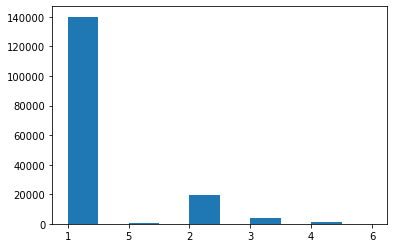

In [10]:
data["level"].hist(grid=False)

# 三、特征数据处理
## 3.1 构造新特征，根据建造年份构造建筑物年龄

In [11]:
import datetime
from datetime import datetime

dt = data["Date"]

# dt = datetime.strptime(dt, '%Y-%m-%d %H:%M:%S')
dt = dt.apply(lambda x:datetime.strptime(x, '%Y/%m/%d'))

data["year_now"] = dt.map(lambda x: x.year)
data['age_of_building'] = data['year_now'] - data['year of construction']
data.drop(columns=['year_now', 'Date', 'YYYYMM', 'USPD', 'type'], inplace=True)
data.head()

,M1,M2,delta_M,T1,T2,delta_T,Q,registrated,scheme,area,floors,walls material,year of construction,area of building,temp,level,age_of_building
0,102.51,92.05,10.46,81.99,53.36,28.63,2.94,Heating + Hot water,opened,2707.4,5,panel,1983,4401.0,-17.782121,1,33
1,124.86,125.29,-0.43,82.58,50.24,32.34,4.05,Heating + Hot water,closed,3358.4,5,brick,1974,3610.4,-17.782121,1,42
2,127.31,128.51,-1.20,83.26,51.72,31.55,4.02,Heating + Hot water,closed,3153.5,5,brick,1975,3150.2,-17.782121,1,41
3,86.36,81.61,4.75,92.55,54.82,37.73,3.26,Heating + Hot water,opened,2646.5,5,panel,1982,2932.7,-17.782121,1,34
4,170.81,168.74,2.07,83.29,59.70,23.59,4.04,Heating + Hot water,closed,3187.5,5,brick,1976,3456.2,-17.782121,1,40


In [12]:
building_result = pd.DataFrame(data['area of building'].unique())
building_result.describe()

,0
count,934.000000
mean,5307.327473
std,4255.068813
min,169.400000
25%,3066.470000
50%,4263.880000
75%,5768.700000
max,32030.920000


In [13]:
building = pd.DataFrame(data['area'].unique())
building.describe()

,0
count,1090.000000
mean,3462.071725
std,2408.090851
min,169.400000
25%,2114.375000
50%,2903.600000
75%,3960.375000
max,18801.100000


In [14]:
data_building = data.groupby([data['area of building'], data['age_of_building'], data['floors'], data['walls material'], data['area']]).mean().reset_index()
data_building

,area of building,age_of_building,floors,walls material,area,M1,M2,delta_M,T1,T2,delta_T,Q,year of construction,temp
0,169.40,129,2,wood,169.40,13.058287,12.427917,0.629954,73.054213,50.636343,22.417639,0.281759,1887,-6.964844
1,207.20,86,1,wood,202.10,17.641212,17.381818,0.259394,65.438788,50.542121,14.896667,0.262424,1930,-13.901228
2,215.20,66,2,wood,214.50,13.842720,11.138720,2.703840,56.844480,37.478640,19.366320,0.257120,1950,-4.933231
3,345.50,63,2,wood,332.80,19.067500,18.548333,0.519167,78.727500,60.502500,18.225000,0.351667,1953,-15.604504
4,361.80,64,2,wood,333.20,33.065000,32.086429,0.978571,82.834286,67.887857,14.946429,0.501429,1952,-15.629212
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1096,32030.92,29,10,panel,2181.50,61.412846,56.802308,4.610538,79.211615,48.568846,30.642769,1.898000,1987,-7.592666
1097,32030.92,29,10,panel,2346.52,61.550486,56.954583,4.595903,78.855208,47.604861,31.250347,1.934861,1987,-7.407624
1098,32030.92,29,10,panel,2352.60,69.711131,63.924107,5.787024,78.254940,46.699226,31.555714,2.197202,1987,-6.957637
1099,32030.92,29,10,panel,2367.50,64.307122,61.679209,2.627914,80.212590,48.519496,31.693094,2.059209,1987,-8.720614


## 3.2 将类别数据OneHot Encoder处理

In [15]:
c = LabelEncoder().fit_transform(data['scheme'])
df_scheme = pd.DataFrame(c)
df_scheme.columns=['scheme']

c = LabelEncoder().fit_transform(data['floors'])
df_floors = pd.DataFrame(c)
df_floors.columns=['floors']

c = LabelEncoder().fit_transform(data['walls material'])
df_wallsMaterial = pd.DataFrame(c)
df_wallsMaterial.columns=['walls material']

c = LabelEncoder().fit_transform(data['registrated'])
df_registered = pd.DataFrame(c)
df_registered.columns=['registrated']

df_x=np.concatenate([df_scheme,df_wallsMaterial,df_registered,df_floors],axis=-1)
df_Label =pd.DataFrame(df_x)
df_Label

,0,1,2,3
0,1,3,1,4
1,0,1,1,4
2,0,1,1,4
3,1,3,1,4
4,0,1,1,4
...,...,...,...,...
164787,1,3,1,8
164788,1,3,1,4
164789,0,3,1,9
164790,0,1,1,4


In [16]:

data_Label = data.drop(columns=['scheme', 'registrated', 'floors', 'walls material'])
for item in df_Label.columns:
    data_Label[str(item)]=df_Label[item].values

data_Label.rename(columns={'0':'scheme', '1':'walls material', '2':'registered', '3':'floors'}, inplace=True)
data_Label

,M1,M2,delta_M,T1,T2,delta_T,Q,area,year of construction,area of building,temp,level,age_of_building,scheme,walls material,registered,floors
0,102.51,92.05,10.46,81.99,53.36,28.63,2.94,2707.4,1983,4401.00,-17.782121,1,33,1,3,1,4
1,124.86,125.29,-0.43,82.58,50.24,32.34,4.05,3358.4,1974,3610.40,-17.782121,1,42,0,1,1,4
2,127.31,128.51,-1.20,83.26,51.72,31.55,4.02,3153.5,1975,3150.20,-17.782121,1,41,0,1,1,4
3,86.36,81.61,4.75,92.55,54.82,37.73,3.26,2646.5,1982,2932.70,-17.782121,1,34,1,3,1,4
4,170.81,168.74,2.07,83.29,59.70,23.59,4.04,3187.5,1976,3456.20,-17.782121,1,40,0,1,1,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
164787,102.46,86.99,15.47,77.50,52.95,24.55,2.51,1886.0,1979,13548.30,-8.144842,1,37,1,3,1,8
164788,79.47,71.58,7.89,77.56,48.82,28.74,2.29,2139.1,1964,4262.06,-8.144842,1,52,1,3,1,4
164789,274.49,272.79,1.69,77.89,49.34,28.55,7.86,6609.2,1999,12626.10,-8.144842,2,17,0,3,1,9
164790,436.13,437.33,-1.20,66.52,49.35,17.17,7.50,6447.4,1988,7249.70,-8.144842,2,28,0,1,1,4


In [17]:
data_building = data_Label.groupby([data_Label['area of building'], data_Label['age_of_building'], data_Label['floors'], data_Label['walls material'], data_Label['area']]).mean().reset_index()
data_building

,area of building,age_of_building,floors,walls material,area,M1,M2,delta_M,T1,T2,delta_T,Q,year of construction,temp,scheme,registered
0,169.40,129,1,4,169.40,13.058287,12.427917,0.629954,73.054213,50.636343,22.417639,0.281759,1887.0,-6.964844,1.0,1.0
1,207.20,86,0,4,202.10,17.641212,17.381818,0.259394,65.438788,50.542121,14.896667,0.262424,1930.0,-13.901228,0.0,1.0
2,215.20,66,1,4,214.50,13.842720,11.138720,2.703840,56.844480,37.478640,19.366320,0.257120,1950.0,-4.933231,1.0,1.0
3,345.50,63,1,4,332.80,19.067500,18.548333,0.519167,78.727500,60.502500,18.225000,0.351667,1953.0,-15.604504,0.0,0.0
4,361.80,64,1,4,333.20,33.065000,32.086429,0.978571,82.834286,67.887857,14.946429,0.501429,1952.0,-15.629212,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1096,32030.92,29,9,3,2181.50,61.412846,56.802308,4.610538,79.211615,48.568846,30.642769,1.898000,1987.0,-7.592666,1.0,1.0
1097,32030.92,29,9,3,2346.52,61.550486,56.954583,4.595903,78.855208,47.604861,31.250347,1.934861,1987.0,-7.407624,1.0,1.0
1098,32030.92,29,9,3,2352.60,69.711131,63.924107,5.787024,78.254940,46.699226,31.555714,2.197202,1987.0,-6.957637,1.0,1.0
1099,32030.92,29,9,3,2367.50,64.307122,61.679209,2.627914,80.212590,48.519496,31.693094,2.059209,1987.0,-8.720614,1.0,1.0


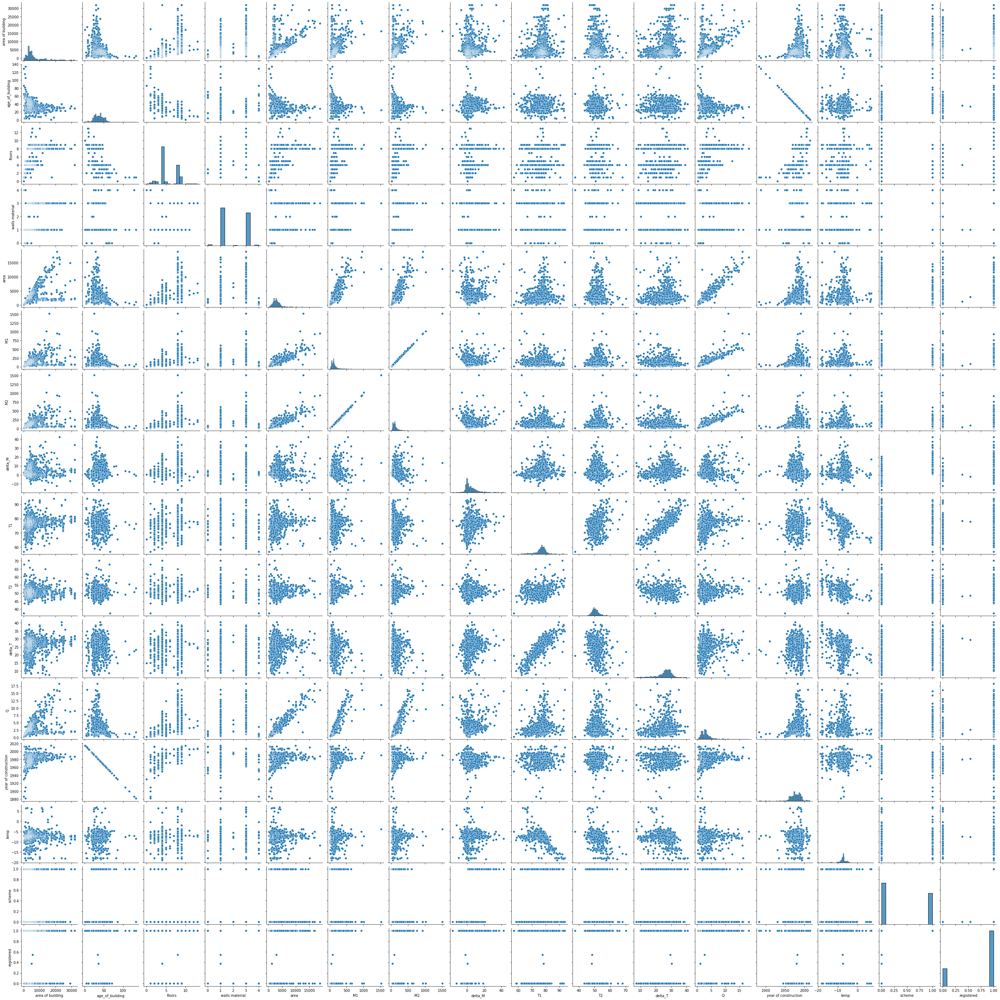

In [18]:
sns.pairplot(data=data_building)
plt.show()

## 3.3 处理目标值类别不平衡数

In [19]:
from imbalanced_ensemble.ensemble import SelfPacedEnsembleClassifier
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
X = data_Label.drop(columns=['Q','level', 'year of construction'])
y = data['level']
X.shape

(164792, 14)

In [20]:
from imblearn.over_sampling import RandomOverSampler  # 随机重复采样
from imblearn.over_sampling import SMOTE  # 选取少数类样本插值采样
from imblearn.combine import SMOTEENN

from collections import Counter
#在之前的SMOTE方法中, 当由边界的样本与其他样本进行过采样差值时, 很容易生成一些噪音数据. 因此, 在过采样之后需要对样本进行清洗. 这样, 第三节中涉及到的TomekLink 与 EditedNearestNeighbours方法就能实现上述的要求. 所以就有了两种结合过采样与下采样的方法: (i) SMOTETomek and (ii) SMOTEENN.
smo = SMOTEENN(random_state=42)
X_smo, y_smo = smo.fit_resample(X, y.astype('int'))

print(Counter(y_smo))
y_smo

Counter({5: 140099, 6: 140099, 4: 139998, 3: 139818, 2: 138643, 1: 137303})


0         1
1         1
2         1
3         1
4         1
         ..
835955    6
835956    6
835957    6
835958    6
835959    6
Name: level, Length: 835960, dtype: int64

clf = SelfPacedEnsembleClassifier(random_state=42)
clf.fit(X_train, y_train)
clf.predict(X_test)

from imbalanced_ensemble.ensemble import SelfPacedEnsembleClassifier
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split

X, y = make_classification(n_samples=1000, n_classes=3,
                            n_informative=4, weights=[0.2, 0.3, 0.5],
                            random_state=0)
X_train, X_test, y_train, y_test = train_test_split(
                            X, y, test_size=0.2, random_state=42)
clf = SelfPacedEnsembleClassifier(random_state=0)
clf.fit(X_train, y_train)
SelfPacedEnsembleClassifier(...)
clf.predict(X_test) 
X_train.shape, y_train.shape

In [21]:
X_smo.describe()

,M1,M2,delta_M,T1,T2,delta_T,area,area of building,temp,age_of_building,scheme,walls material,registered,floors
count,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000,835960.000000
mean,468.950089,462.350228,6.599902,87.045809,56.272663,30.773165,10676.024293,14594.637456,-14.927570,32.819067,0.219841,2.474981,0.866074,7.384307
std,263.608707,262.164362,11.754706,11.443670,6.164136,7.797335,5215.713734,7093.639528,9.067699,8.369608,0.414139,0.879007,0.340573,1.736678
min,1.210000,0.010000,-25.600000,40.010000,6.380000,2.050000,169.400000,169.400000,-32.582617,1.000000,0.000000,0.000000,0.000000,0.000000
25%,227.637905,222.200199,-0.180000,78.499455,52.040000,25.949876,5615.300000,8013.300000,-21.807943,29.000000,0.000000,1.000000,1.000000,8.000000
50%,490.299452,478.266445,4.864489,90.912150,56.757470,32.304051,12162.100000,15173.800000,-16.663138,33.000000,0.000000,3.000000,1.000000,8.000000
75%,681.325273,671.378745,9.618076,95.709934,61.329102,35.633214,15215.676231,22142.520000,-10.130725,36.000000,0.000000,3.000000,1.000000,8.000000
max,1675.390000,1659.390000,514.310000,116.990000,84.780000,62.710000,18801.100000,32030.920000,16.963864,134.000000,1.000000,4.000000,1.000000,13.000000


In [22]:
data_smo = pd.concat([X_smo, y_smo],axis=1)
data_smo.head()

,M1,M2,delta_M,T1,T2,delta_T,area,area of building,temp,age_of_building,scheme,walls material,registered,floors,level
0,102.51,92.05,10.46,81.99,53.36,28.63,2707.4,4401.0,-17.782121,33,1,3,1,4,1
1,124.86,125.29,-0.43,82.58,50.24,32.34,3358.4,3610.4,-17.782121,42,0,1,1,4,1
2,127.31,128.51,-1.20,83.26,51.72,31.55,3153.5,3150.2,-17.782121,41,0,1,1,4,1
3,86.36,81.61,4.75,92.55,54.82,37.73,2646.5,2932.7,-17.782121,34,1,3,1,4,1
4,170.81,168.74,2.07,83.29,59.70,23.59,3187.5,3456.2,-17.782121,40,0,1,1,4,1


## 3.5 进行数据采样

In [23]:
data_sample=data_smo.sample(frac=0.1,axis=0)
data_sample.describe()

,M1,M2,delta_M,T1,T2,delta_T,area,area of building,temp,age_of_building,scheme,walls material,registered,floors,level
count,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000
mean,469.363955,462.766720,6.597275,87.031611,56.280860,30.750775,10684.786958,14614.106251,-14.885836,32.775121,0.219281,2.474783,0.864395,7.384265,3.512297
std,263.419741,261.952863,11.749187,11.424291,6.165622,7.781685,5213.772482,7105.445413,9.070909,8.356717,0.413762,0.878925,0.342370,1.736570,1.704816
min,1.210000,0.020000,-25.571508,40.260000,18.500000,2.380000,169.400000,169.400000,-32.582617,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,228.488926,222.867202,-0.190000,78.472307,52.050000,25.860000,5703.900000,8013.300000,-21.763011,29.000000,0.000000,1.000000,1.000000,8.000000,2.000000
50%,491.228774,479.399033,4.851203,90.877176,56.746074,32.293135,12162.100000,15173.800000,-16.638829,33.000000,0.000000,3.000000,1.000000,8.000000,4.000000
75%,682.873517,672.235540,9.611308,95.690417,61.326602,35.630588,15287.713604,22142.520000,-10.105407,36.000000,0.000000,3.000000,1.000000,8.000000,5.000000
max,1670.915819,1654.923879,307.350000,116.986982,77.790000,62.705905,18801.100000,32030.920000,16.963864,134.000000,1.000000,4.000000,1.000000,13.000000,6.000000


<AxesSubplot:>

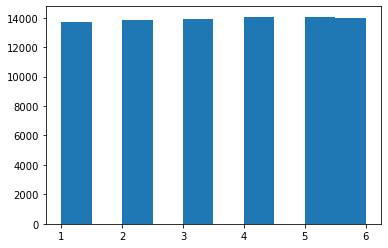

In [24]:
data_sample["level"].hist(grid=False)

In [25]:
sample_X = data_sample.drop(columns=['level'])
sample_y = data_sample['level']
sample_X.describe()

,M1,M2,delta_M,T1,T2,delta_T,area,area of building,temp,age_of_building,scheme,walls material,registered,floors
count,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000,83596.000000
mean,469.363955,462.766720,6.597275,87.031611,56.280860,30.750775,10684.786958,14614.106251,-14.885836,32.775121,0.219281,2.474783,0.864395,7.384265
std,263.419741,261.952863,11.749187,11.424291,6.165622,7.781685,5213.772482,7105.445413,9.070909,8.356717,0.413762,0.878925,0.342370,1.736570
min,1.210000,0.020000,-25.571508,40.260000,18.500000,2.380000,169.400000,169.400000,-32.582617,1.000000,0.000000,0.000000,0.000000,0.000000
25%,228.488926,222.867202,-0.190000,78.472307,52.050000,25.860000,5703.900000,8013.300000,-21.763011,29.000000,0.000000,1.000000,1.000000,8.000000
50%,491.228774,479.399033,4.851203,90.877176,56.746074,32.293135,12162.100000,15173.800000,-16.638829,33.000000,0.000000,3.000000,1.000000,8.000000
75%,682.873517,672.235540,9.611308,95.690417,61.326602,35.630588,15287.713604,22142.520000,-10.105407,36.000000,0.000000,3.000000,1.000000,8.000000
max,1670.915819,1654.923879,307.350000,116.986982,77.790000,62.705905,18801.100000,32030.920000,16.963864,134.000000,1.000000,4.000000,1.000000,13.000000


In [26]:
import numpy as np
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split


def set_parameters(
    model,
    X,
    y,
    fit: str = "fit",
    predict: str = "predict",
    threshold: float = 0.5,
    test_size: float = 0.2,
    **kwrgs
):
    def fitness(x):
        mdl = model(**kwrgs)
        return fitness_function(
            x, mdl, X, y, threshold, test_size, fit=fit, predict=predict
        )

    return fitness


def fitness_function(
    x,
    model,
    X,
    y,
    threshold: float = 0.5,
    test_size: float = 0.2,
    fit: str = "fit",
    predict: str = "predict",
):

    X_train, X_test, y_train, y_test = train_test_split(
        X, y, shuffle=True, test_size=test_size
    )

    par_ = [1 if col > threshold else 0 for col in x]
    cols = np.argwhere(par_ == np.amax(par_)).reshape(
        -1,
    )
    x_train = X_train[:, cols]
    x_test = X_test[:, cols]

    getattr(model, fit)(x_train, y_train)

    y_p = getattr(model, predict)(x_test)
    acc = accuracy_score(y_test, y_p)

    return 1 - acc



def PSO(
    fitness_function,
    particle_size: int,
    particle_dim: int,
    bounds: list,
    intertial_weight: int,
    particle_coeff: int,
    swarm_coeff: int,
    epochs: int,
    threshold_epochs: int = None,
    verbose: float = False,
):

    pop = np.array([bounds[0]] * particle_dim) + np.array(
        [abs(bounds[1] - bounds[0])] * particle_dim
    ) * np.random.rand(
        particle_size, particle_dim
    )  # initial population

    vel = np.array([bounds[0]] * particle_dim) + np.array(
        [abs(bounds[1] - bounds[0]) / 2] * particle_dim
    ) * np.random.rand(particle_size, particle_dim)

    fit = np.array([fitness_function(p) for p in pop])

    if verbose:
        all_featues = np.ones(particle_dim)
        print(f"Initial Accuracy: %.3f." % (1 - fitness_function(all_featues)))

    pbest = np.copy(pop)
    f_pbest = np.copy(fit)

    f_gbest, gbest = np.min(f_pbest), pbest[np.argmin(f_pbest)]
    best_fit_epochs = []
    best_particle_epochs = []

    # iterating over the entire population

    for epoch in range(epochs):
        if verbose:
            print("----------------------------------")
            print(
                "*  Epoch: {epoch:{width}}".format(
                    epoch=epoch + 1, width=len(str(epochs))
                ),
                end=" | ",
            )

        # updating individuals in the population

        for p in range(particle_size):

            vel[p, :] = (
                (intertial_weight * vel[p, :])
                + (
                    particle_coeff
                    * np.random.rand(1, particle_dim)
                    * (pbest[p, :] - pop[p, :])
                )
                + (swarm_coeff * np.random.rand(1, particle_dim) * (gbest - pop[p, :]))
            )

            pop[p, :] += vel[p, :]
            pop[p, :] = np.where(pop[p] > 1, 1.0, np.where(pop[p] < 0, 0.0, pop[p]))

            fit[p] = fitness_function(pop[p, :])

            if fit[p] < f_pbest[p]:
                f_pbest[p] = fit[p]
                pbest[p] = pop[p]

                if f_pbest[p] < f_gbest:
                    f_gbest = f_pbest[p]
                    gbest = pbest[p]

        if verbose:
            print("Accuracy: %.3f." % (1 - f_gbest))

        best_fit_epochs.append(f_gbest)
        best_particle_epochs.append(gbest)
        if (
            threshold_epochs
            and len(best_fit_epochs) >= threshold_epochs
            and np.all(best_fit_epochs[-1] == best_fit_epochs[-threshold_epochs:])
        ):
            break

    if verbose:
        print("----------------------------------")

    return (best_fit_epochs, best_particle_epochs)


def PSOptimizer(
    dataset: tuple,
    model,
    fit: str = "fit",
    predict: str = "predict",
    epochs: int = 10,
    threshold: float = 0.5,
    test_size: float = 0.2,
    early_stopping: bool = False,
    verbose: bool = False,
    **kwargs
):
    """
    Particle Swarm Optimizer
    ------------------------
    Parameters
    ----------
    - dataset : tuple, default=None
        The dataset to find optimized features for.
    - model : function, default=None
        The model which is to be trained to make predictions on the dataset.
    - fit : str, default='fit'
        THe method used by the model to fit to training data.
    - predict : str, default='predict'
        THe method used by the model to predict given the input.
    Output
    ------
    - accuracy : Best accuracy score found by the optimizer.
    - features : features which get the best accuracy attanined.
    """

    opt = "PSO"

    X, y = dataset

    # setting hyperparameters

    DIM = X.shape[1]
    BOUNDS = [0.0, 1.0]

    EPOCHS = epochs  # the number of iterations for which the swarm will train
    w = 0.50  # inertial value for effect of current velocity
    c1 = 0.45  # coeff for effect of particle best position
    c2 = 0.55  # coeff for effect of swarm best position
    SIZE = 50  # number of particles

    fitness = set_parameters(model, X, y, fit, predict, threshold, test_size, **kwargs)

    losses, features = PSO(
        fitness,
        SIZE,
        DIM,
        BOUNDS,
        w,
        c1,
        c2,
        EPOCHS,
        int(EPOCHS / 5) if early_stopping else None,
        verbose,
    )
    loss, feature = losses[-1], features[-1]
    accuracy = 1 - loss

    feature = [1 if attr > threshold else 0 for attr in feature]
    feature = np.argwhere(feature == np.max(feature)).reshape(
        -1,
    )

    return (accuracy, feature)


In [28]:
from sklearn.ensemble import RandomForestClassifier

X = sample_X.to_numpy()
y = sample_y.to_numpy()
best_accuracy, index_of_best_features = PSOptimizer((X, y), RandomForestClassifier, epochs = 10, threshold=0.6, verbose=1, max_depth=6)

Initial Accuracy: 0.943.
----------------------------------
*  Epoch:  1 | Accuracy: 0.945.
----------------------------------
*  Epoch:  2 | Accuracy: 0.948.
----------------------------------
*  Epoch:  3 | Accuracy: 0.948.
----------------------------------
*  Epoch:  4 | Accuracy: 0.949.
----------------------------------
*  Epoch:  5 | Accuracy: 0.949.
----------------------------------
*  Epoch:  6 | Accuracy: 0.949.
----------------------------------
*  Epoch:  7 | Accuracy: 0.949.
----------------------------------
*  Epoch:  8 | Accuracy: 0.949.
----------------------------------
*  Epoch:  9 | Accuracy: 0.949.
----------------------------------
*  Epoch: 10 | Accuracy: 0.949.
----------------------------------


In [29]:
index_of_best_features

array([ 0,  1,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13])

In [30]:
PSOptimizer_Feature = sample_X.iloc[:,index_of_best_features]
PSOptimizer_Feature

,M1,M2,T1,T2,delta_T,area,temp,age_of_building,scheme,walls material,registered,floors
238982,670.823212,667.052456,64.127857,53.156704,10.971153,10352.00,9.193936,11,0,1,1,9
759586,736.854366,731.749822,95.938183,61.044546,34.893636,16849.98,-21.727279,33,0,3,1,8
81832,59.340000,55.090000,65.860000,45.920000,19.940000,2129.20,5.068200,29,1,3,1,9
410557,612.572098,607.826296,72.185801,54.573023,17.608302,10352.00,-9.363127,11,0,1,1,9
469311,507.218654,468.791264,84.297875,51.678005,32.619870,14515.50,-12.485523,32,1,3,1,8
...,...,...,...,...,...,...,...,...,...,...,...,...
512672,554.655291,562.975660,95.104351,60.120568,34.983783,14812.01,-17.866365,29,0,3,0,8
306830,632.275398,631.757246,68.373314,50.819238,17.554076,11660.60,-4.250116,21,0,3,1,9
435621,660.126263,663.190436,81.938380,56.945303,24.993077,12111.10,-10.710233,38,0,3,1,8
68540,104.900000,104.680000,66.240000,44.610000,21.640000,2688.70,7.871414,30,0,3,1,4


## 降维

In [35]:
from itertools import product

import numpy as np
from sklearn.base import BaseEstimator, ClusterMixin
from sklearn.utils import check_random_state
from sklearn.utils.validation import check_array
from sklearn.preprocessing import minmax_scale
from somoclu import Somoclu


class SOM(BaseEstimator, ClusterMixin):
    """Class to fit and visualize a Self-Organizing Map (SOM).
    The implementation uses SOM from Somoclu.
    Read more in the :ref:`User Guide <user_guide>`.
    Parameters
    ----------
    n_columns : int, optional (default=5)
        The number of columns in the map.
    n_rows : int, optional (default=5)
        The number of rows in the map.
    initialcodebook : 2D numpy.array of float32, str or None, optional (default=None)
        Define the codebook to start the training. If ``initialcodebook='pca'`` then
        the codebook is initialized from the first subspace spanned by the first two
        eigenvectors of the correlation matrix.
    kerneltype : int, optional (default=0)
        Specify which kernel to use. If ``kerneltype=0`` use dense CPU kernel.
        Else if ``kerneltype=1`` use dense GPU kernel if compiled with it.
    maptype : str, optional (default='planar')
        Specify the map topology. If ``maptype='planar'`` use planar map.
        Else if ``maptype='toroid'`` use toroid map.
    gridtype : str, optional (default='rectangular')
        Specify the grid form of the nodes. If ``gridtype='rectangular'``
        use rectangular neurons. Else if ``gridtype='hexagonal'`` use
        hexagonal neurons.
    compactsupport : bool, optional (default=True)
        Cut off map updates beyond the training radius with the Gaussian neighborhood.
    neighborhood : str, optional (default='gaussian')
        Specify the neighborhood. If ``neighborhood='gaussian'`` use
        Gaussian neighborhood. Else if `neighborhood='bubble'`` use
        bubble neighborhood function.
    std_coeff : float, optional (default=0.5)
        Set the coefficient in the Gaussian
        neighborhood :math:`exp(-||x-y||^2/(2*(coeff*radius)^2))`.
    random_state : int, RandomState instance or None, optional (default=None)
        Control the randomization of the algorithm by specifying the
        codebook initalization. It is ignored when ``initialcodebook`` is
        not ``None``.
        - If int, ``random_state`` is the seed used by the random number
          generator.
        - If ``RandomState`` instance, random_state is the random number
          generator.
        - If ``None``, the random number generator is the ``RandomState``
          instance used by ``np.random``.
    verbose : int, optional (default=0)
        Specify verbosity level (0, 1, or 2).
    """

    _attributes = ['train', 'codebook', 'bmus']

    def __init__(
        self,
        n_columns=5,
        n_rows=5,
        initialcodebook=None,
        kerneltype=0,
        maptype="planar",
        gridtype="rectangular",
        compactsupport=True,
        neighborhood="gaussian",
        std_coeff=0.5,
        random_state=None,
        verbose=0,
    ):

        self.n_columns = n_columns
        self.n_rows = n_rows
        self.initialcodebook = initialcodebook
        self.kerneltype = kerneltype
        self.maptype = maptype
        self.gridtype = gridtype
        self.compactsupport = compactsupport
        self.neighborhood = neighborhood
        self.std_coeff = std_coeff
        self.random_state = random_state
        self.verbose = verbose

    @staticmethod
    def _generate_labels_mapping(grid_labels):
        """Generate a mapping between grid labels and cluster labels."""

        # Identify unique grid labels
        unique_labels = [
            tuple(grid_label) for grid_label in np.unique(grid_labels, axis=0)
        ]

        # Generate mapping
        labels_mapping = {
            grid_label: cluster_label
            for grid_label, cluster_label in zip(
                unique_labels, range(len(unique_labels))
            )
        }

        return labels_mapping

    def _return_topological_neighbors(self, col, row):
        """Return the topological neighbors of a neuron."""

        # Return common topological neighbors for the two grid types
        topological_neighbors = [
            (col - 1, row),
            (col + 1, row),
            (col, row - 1),
            (col, row + 1),
        ]

        # Append extra topological neighbors for hexagonal grid type
        if self.gridtype == 'hexagonal':
            offset = (-1) ** row
            topological_neighbors += [
                (col - offset, row - offset),
                (col - offset, row + offset),
            ]

        # Apply constraints
        topological_neighbors = [
            (col, row)
            for col, row in topological_neighbors
            if 0 <= col < self.n_columns
            and 0 <= row < self.n_rows
            and [col, row] in self.algorithm_.bmus.tolist()
        ]

        return topological_neighbors

    def _generate_neighbors(self, grid_labels, labels_mapping):
        """Generate pairs of neighboring labels."""

        # Generate grid topological neighbors
        grid_topological_neighbors = [
            product(
                [tuple(grid_label)], self._return_topological_neighbors(*grid_label)
            )
            for grid_label in grid_labels
        ]

        # Flatten grid topological neighbors
        grid_topological_neighbors = [
            pair for pairs in grid_topological_neighbors for pair in pairs
        ]

        # Generate cluster neighbors
        all_neighbors = [
            (labels_mapping[pair[0]], labels_mapping[pair[1]])
            for pair in grid_topological_neighbors
        ]
        all_neighbors = [tuple(pair) for pair in np.unique(all_neighbors, axis=0)]

        # Keep unique unordered pairs
        neighbors = []
        for pair in all_neighbors:
            if pair not in neighbors and pair[::-1] not in neighbors:
                neighbors.append(pair)

        return np.array(neighbors)

    def fit(self, X, y=None, **fit_params):
        """Train the self-organizing map.
        Parameters
        ----------
        X : array-like or sparse matrix, shape=(n_samples, n_features)
            Training instances to cluster.
        y : Ignored
        """

        # Check and normalize input data
        X = minmax_scale(check_array(X, dtype=np.float32))

        # Check random_state
        self.random_state_ = check_random_state(self.random_state)

        # Initialize codebook
        if self.initialcodebook is None:
            if self.random_state is None:
                initialcodebook = None
                initialization = 'random'
            else:
                codebook_size = self.n_columns * self.n_rows * X.shape[1]
                initialcodebook = self.random_state_.random_sample(
                    codebook_size
                ).astype(np.float32)
                initialization = None
        elif self.initialcodebook == 'pca':
            initialcodebook = None
            initialization = 'random'
        else:
            initialcodebook = self.initialcodebook
            initialization = None

        # Create Somoclu object
        self.algorithm_ = Somoclu(
            n_columns=self.n_columns,
            n_rows=self.n_rows,
            initialcodebook=initialcodebook,
            kerneltype=self.kerneltype,
            maptype=self.maptype,
            gridtype=self.gridtype,
            compactsupport=self.compactsupport,
            neighborhood=self.neighborhood,
            std_coeff=self.std_coeff,
            initialization=initialization,
            data=None,
            verbose=self.verbose,
        )

        # Fit Somoclu
        self.algorithm_.train(data=X, **fit_params)

        # Grid labels
        grid_labels = [tuple(grid_label) for grid_label in self.algorithm_.bmus]

        # Generate labels mapping
        self.labels_mapping_ = self._generate_labels_mapping(grid_labels)

        # Generate cluster labels
        self.labels_ = np.array(
            [self.labels_mapping_[grid_label] for grid_label in grid_labels]
        )

        # Generate labels neighbors
        self.neighbors_ = self._generate_neighbors(
            np.unique(grid_labels, axis=0), self.labels_mapping_
        )

        return self

    def fit_predict(self, X, y=None, **fit_params):
        """Train the self-organizing map and assign a cluster label to each sample.
        Parameters
        ----------
        X : {array-like, sparse matrix}, shape = [n_samples, n_features]
            New data to transform.
        u : Ignored
        Returns
        -------
        labels : array, shape [n_samples,]
            Index of the cluster each sample belongs to.
        """
        return self.fit(X, **fit_params).labels_

If you installed Somoclu with pip on macOS, this typically means missing a linked library. If you compiled Somoclu with GCC, please make sure you have set DYLD_LIBRARY_PATH to include the GCC path. For more information, please refer to the documentation.


# 四、模型构造

In [31]:
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from mlxtend.classifier import StackingCVClassifier
from xgboost import XGBClassifier

RANDOM_SEED = 42

# 四、构造stacking模型
采用GDBT，RF，XGBoost构造集成模型

In [32]:
clf1 = GradientBoostingClassifier(random_state=RANDOM_SEED)
clf2 = RandomForestClassifier(random_state=RANDOM_SEED)
clf3 = XGBClassifier(learning_rate=0.1,n_estimators=1000, max_depth=6, min_child_weight = 1, gamma=0., subsample=0.8, colsample_btree=0.8, objective='multi:softmax', scale_pos_weight=1,random_state=RANDOM_SEED)
lr = LogisticRegression()

sclf = StackingCVClassifier(classifiers=[clf1, clf2, clf3],  # 第一层分类器
                            meta_classifier=lr,   # 第二层分类器
                            random_state=RANDOM_SEED)

print('3-fold cross validation:\n')

for clf, label in zip([clf1, clf2, clf3, sclf], ['KNN', 'Random Forest', 'Naive Bayes','StackingClassifier']):
    scores = cross_val_score(clf, sample_X, sample_y, cv=3, scoring='accuracy')
    print("Accuracy: %0.2f (+/- %0.2f) [%s]" % (scores.mean(), scores.std(), label))

3-fold cross validation:

Accuracy: 0.99 (+/- 0.00) [KNN]
Accuracy: 1.00 (+/- 0.00) [Random Forest]
[16:04:05] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-6691-43e9a6c0910f/volume/xgboost-split_1619728204606/work/src/learner.cc:541: 
Parameters: { colsample_btree, scale_pos_weight } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[16:04:06] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-6691-43e9a6c0910f/volume/xgboost-split_1619728204606/work/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:05:33] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-66

In [33]:
sclf

StackingCVClassifier(classifiers=[GradientBoostingClassifier(random_state=42),
                                  RandomForestClassifier(random_state=42),
                                  XGBClassifier(base_score=None, booster=None,
                                                colsample_btree=0.8,
                                                colsample_bylevel=None,
                                                colsample_bynode=None,
                                                colsample_bytree=None,
                                                gamma=0.0, gpu_id=None,
                                                importance_type='gain',
                                                interaction_constraints=None,
                                                learning_rate=0.1,
                                                max_delta_step=None,
                                                max_depth=6, min_child_weight=1,
                                             

## 4.1 堆叠5折CV分类与网格搜索(结合网格搜索调参优化)

In [34]:

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from mlxtend.classifier import StackingCVClassifier

# Initializing models

clf1 = GradientBoostingClassifier(random_state=RANDOM_SEED)
clf2 = RandomForestClassifier(random_state=RANDOM_SEED)
clf3 = XGBClassifier(learning_rate=0.1,n_estimators=1000, max_depth=6, min_child_weight = 1, gamma=0., subsample=0.8, eval_metric='mlogloss',objective='binary:logistic', random_state=RANDOM_SEED)
lr = LogisticRegression()

sclf = StackingCVClassifier(classifiers=[clf1, clf2, clf3], 
                            meta_classifier=lr,
                            random_state=42)

params = {'meta_classifier__C': [0.1, 10.0]}

grid = GridSearchCV(estimator=sclf, 
                    param_grid=params, 
                    cv=5,
                    refit=True)
grid.fit(X, y)

cv_keys = ('mean_test_score', 'std_test_score', 'params')

for r, _ in enumerate(grid.cv_results_['mean_test_score']):
    print("%0.3f +/- %0.2f %r"
          % (grid.cv_results_[cv_keys[0]][r],
             grid.cv_results_[cv_keys[1]][r] / 2.0,
             grid.cv_results_[cv_keys[2]][r]))

print('Best parameters: %s' % grid.best_params_)
print('Accuracy: %.2f' % grid.best_score_)

[16:27:04] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-6691-43e9a6c0910f/volume/xgboost-split_1619728204606/work/src/learner.cc:541: 
Parameters: { colsample_btree, scale_pos_weight } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[16:27:04] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-6691-43e9a6c0910f/volume/xgboost-split_1619728204606/work/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:27:59] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-6691-43e9a6c0910f/volume/xgboost-split_1619728204606/work/src/learner.cc:541: 
Parameters: { colsample

In [36]:
data_2015 = pd.read_csv('2015.csv')
import autoBinning
from autoBinning.utils.forwardSplit import *
# sby='woeiv'时考虑woe趋势，sby='iv'时不考虑woe趋势
t = forwardSplit(data_2015['Q, Gcal'], data_2015['Q, Gcal'])
t.fit(sby='iv',minv=0.1,init_split=6)
print(t.bins) 
t = forwardSplit(data_2015['Q, Gcal'], data_2015['Q, Gcal'])
t.fit(sby='iv',num_split=6,init_split=6)
print(t.bins) 
t.fit(sby='woeiv',num_split=6,init_split=6)
print(t.bins)

print("bin\twoe")
for i in range(len(t.bins)-1):
    v = t.value[(t.x < t.bins[i+1]) & (t.x >= t.bins[i])]
    woe = t._cal_woe(v)
    print((t.bins[i], t.bins[i+1]),woe)
from pandas import Series, DataFrame
bins=[0,5,10,15,20,25,30]
bin_data = pd.cut(data_2015['Q, Gcal'], bins)
print(pd.value_counts(bin_data))

def func(x):
    if ((x<5) & (x>0)):
        return "1"
    elif ((x>=5) & (x<10)):
        return "2"
    elif ((x>=10) & (x<15)):
        return "3"
    elif ((x>=15) & (x<20)):  
        return "4"
    elif ((x>=20) & (x<25)):  
        return "5"
    elif ((x>=25) & (x<30)):
        return "6"
    elif (x>=30):
        return "7"
    else:
        return 'N/A'
data_2015['level'] = data_2015['Q, Gcal'].apply(func)
data_2015.describe()

None
[1.000e-02 1.340e+00 1.930e+00 2.965e+01]
[1.000e-02 1.340e+00 1.930e+00 2.500e+00 3.220e+00 4.420e+00 2.965e+01]
bin	woe
(0.01, 1.34) 1.8103900165938955
(1.34, 1.93) 0
(1.93, 2.5) 0
(2.5, 3.22) 0
(3.22, 4.42) 0
(4.42, 29.65) 0
(0, 5]      150926
(5, 10]      17183
(10, 15]      3542
(15, 20]       811
(20, 25]        98
(25, 30]         7
Name: Q, Gcal, dtype: int64


,"М1, t","М2, t","ΔМ, t","Т1, °C","Т2, °C","ΔТ, °C","Q, Gcal",USPD,YYYYMM,type,area,floors,year of construction,area of building,"temp,˚C"
count,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000
mean,144.345411,139.770653,4.574765,72.463755,49.795128,22.668633,3.100437,1107.804760,201519.620014,1650.626545,3455.761014,6.557285,1978.929019,7242.541120,-4.081034
std,120.503963,118.900383,15.371093,9.316013,5.645538,6.873120,2.402012,789.070162,37.159725,475.027188,2346.394561,2.342175,12.493900,6406.722269,8.881850
min,0.470000,0.010000,-26.400000,40.050000,18.300000,2.030000,0.010000,1.000000,201501.000000,1101.000000,121.800000,1.000000,1882.000000,121.800000,-30.545012
25%,73.595000,70.030000,-0.090000,65.590000,46.240000,18.130000,1.630000,456.000000,201502.000000,1105.000000,2124.800000,5.000000,1970.000000,3419.600000,-9.892362
50%,113.870000,108.220000,2.380000,71.250000,49.580000,22.320000,2.500000,979.000000,201504.000000,2005.000000,2884.900000,5.000000,1980.000000,4797.740000,-3.161290
75%,168.200000,163.450000,7.390000,78.400000,53.220000,26.950000,3.710000,1678.000000,201510.000000,2105.000000,3946.000000,9.000000,1988.000000,8619.500000,1.674844
max,5723.500000,1774.440000,5173.200000,106.300000,86.700000,56.310000,29.650000,3129.000000,201609.000000,2117.000000,16849.980000,17.000000,2015.000000,32030.920000,16.177975


<AxesSubplot:>

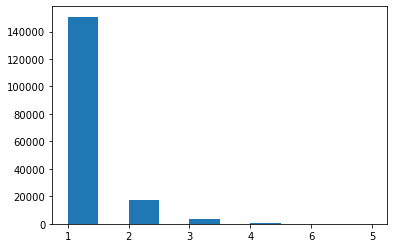

In [37]:
data_2015["level"].hist(grid=False)

In [38]:
import datetime
from datetime import datetime

dt = data_2015["Date"]

# dt = datetime.strptime(dt, '%Y-%m-%d %H:%M:%S')
dt = dt.apply(lambda x:datetime.strptime(x, '%Y/%m/%d'))

data_2015["year_now"] = dt.map(lambda x: x.year)
data_2015['age of building'] = data_2015['year_now'] - data_2015['year of construction']
data_2015.drop(columns=['year_now', 'Date', 'YYYYMM', 'USPD', 'type'], inplace=True)
data_2015.describe()

,"М1, t","М2, t","ΔМ, t","Т1, °C","Т2, °C","ΔТ, °C","Q, Gcal",area,floors,year of construction,area of building,"temp,˚C",age of building
count,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000,172567.000000
mean,144.345411,139.770653,4.574765,72.463755,49.795128,22.668633,3.100437,3455.761014,6.557285,1978.929019,7242.541120,-4.081034,36.070981
std,120.503963,118.900383,15.371093,9.316013,5.645538,6.873120,2.402012,2346.394561,2.342175,12.493900,6406.722269,8.881850,12.493900
min,0.470000,0.010000,-26.400000,40.050000,18.300000,2.030000,0.010000,121.800000,1.000000,1882.000000,121.800000,-30.545012,0.000000
25%,73.595000,70.030000,-0.090000,65.590000,46.240000,18.130000,1.630000,2124.800000,5.000000,1970.000000,3419.600000,-9.892362,27.000000
50%,113.870000,108.220000,2.380000,71.250000,49.580000,22.320000,2.500000,2884.900000,5.000000,1980.000000,4797.740000,-3.161290,35.000000
75%,168.200000,163.450000,7.390000,78.400000,53.220000,26.950000,3.710000,3946.000000,9.000000,1988.000000,8619.500000,1.674844,45.000000
max,5723.500000,1774.440000,5173.200000,106.300000,86.700000,56.310000,29.650000,16849.980000,17.000000,2015.000000,32030.920000,16.177975,133.000000


In [39]:
c = LabelEncoder().fit_transform(data_2015['scheme'])
df_scheme = pd.DataFrame(c)
df_scheme.columns=['scheme']

c = LabelEncoder().fit_transform(data_2015['floors'])
df_floors = pd.DataFrame(c)
df_floors.columns=['floors']

c = LabelEncoder().fit_transform(data_2015['walls material'])
df_wallsMaterial = pd.DataFrame(c)
df_wallsMaterial.columns=['walls material']

c = LabelEncoder().fit_transform(data_2015['registrated'])
df_registered = pd.DataFrame(c)
df_registered.columns=['registrated']

df_x=np.concatenate([df_scheme,df_wallsMaterial,df_registered,df_floors],axis=-1)
df_Label =pd.DataFrame(df_x)

data_Label = data_2015.drop(columns=['scheme', 'registrated', 'floors', 'walls material'])
for item in df_Label.columns:
    data_Label[str(item)]=df_Label[item].values

data_Label.rename(columns={'0':'scheme', '1':'walls material', '2':'registered', '3':'floors'}, inplace=True)
print (data_Label.describe())

               М1, t          М2, t          ΔМ, t         Т1, °C  \
count  172567.000000  172567.000000  172567.000000  172567.000000   
mean      144.345411     139.770653       4.574765      72.463755   
std       120.503963     118.900383      15.371093       9.316013   
min         0.470000       0.010000     -26.400000      40.050000   
25%        73.595000      70.030000      -0.090000      65.590000   
50%       113.870000     108.220000       2.380000      71.250000   
75%       168.200000     163.450000       7.390000      78.400000   
max      5723.500000    1774.440000    5173.200000     106.300000   

              Т2, °C         ΔТ, °C        Q, Gcal           area  \
count  172567.000000  172567.000000  172567.000000  172567.000000   
mean       49.795128      22.668633       3.100437    3455.761014   
std         5.645538       6.873120       2.402012    2346.394561   
min        18.300000       2.030000       0.010000     121.800000   
25%        46.240000      18.1300

In [40]:
X_2015 = data_Label.drop(columns=['Q, Gcal','level', 'year of construction'])
y_2015 = data_2015['level']
X_2015

,"М1, t","М2, t","ΔМ, t","Т1, °C","Т2, °C","ΔТ, °C",area,area of building,"temp,˚C",age of building,scheme,walls material,registered,floors
0,120.51,120.83,-0.32,83.51,48.85,34.65,3358.40,3610.40,-4.959921,41,0,1,1,4
1,123.61,124.93,-1.32,85.14,51.34,33.80,3153.50,3150.20,-4.959921,40,0,1,1,4
2,129.96,129.04,0.93,85.63,51.78,33.85,3187.50,3456.20,-4.959921,39,0,1,1,4
3,102.04,84.42,17.61,85.83,53.30,32.52,2509.35,3382.25,-4.959921,48,1,1,1,4
4,169.23,172.24,-3.02,84.18,56.15,28.03,3574.70,5138.10,-4.959921,33,0,1,1,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
172562,85.13,82.19,2.94,72.13,54.11,18.02,1421.60,1421.60,-5.065225,9,0,1,1,5
172563,90.35,90.29,0.06,75.81,49.66,26.15,2712.70,5679.10,-5.065225,29,0,1,1,4
172564,103.41,103.51,-0.10,75.93,50.86,25.07,2724.90,5647.80,-5.065225,29,0,1,1,4
172565,257.33,258.14,-0.81,75.81,45.48,30.33,9834.00,17149.70,-5.065225,0,0,1,1,10


In [41]:
from sklearn.metrics import accuracy_score  
pre_level_2015 = grid.predict(X_2015)
Accuracy = accuracy_score(y_2015, pre_level_2015)
print ('采用2015年的数据验证由2016年数据训练的模型：Accuracy: %.2f' % Accuracy)

ValueError: feature_names mismatch: ['f0', 'f1', 'f2', 'f3', 'f4', 'f5', 'f6', 'f7', 'f8', 'f9', 'f10', 'f11', 'f12', 'f13'] ['М1, t', 'М2, t', 'ΔМ, t', 'Т1, °C', 'Т2, °C', 'ΔТ, °C', 'area', 'area of building', 'temp,˚C', 'age of building', 'scheme', 'walls material', 'registered', 'floors']
expected f1, f5, f8, f10, f0, f11, f12, f4, f2, f3, f9, f13, f7, f6 in input data
training data did not have the following fields: walls material, М1, t, ΔМ, t, scheme, Т2, °C, Т1, °C, М2, t, area of building, temp,˚C, registered, area, age of building, floors, ΔТ, °C

In [ ]:
y_2015_arr = y_2015.values
y_2015_arr

In [ ]:
from sklearn import preprocessing


y_2015 = label_binarize(y_2015_arr, classes=['1', '2', '3', '4', '5', '6'])
n_classes = y_2015.shape[1]
y_2015

In [ ]:
n_classes

In [ ]:
# 5.ROC曲线 decision_function
### 像其他scikit-learn分类器一样，它StackingCVClassifier具有decision_function可用于绘制ROC曲线的方法。
### 请注意，decision_function期望并要求元分类器实现decision_function。
from sklearn import model_selection
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from mlxtend.classifier import StackingCVClassifier
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn import datasets
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier

RANDOM_SEED = 42

X_train, X_test, y_train, y_test = train_test_split(
    X_2015, y_2015, test_size=0.33, random_state=RANDOM_SEED)

# Learn to predict each class against the other
classifier = OneVsRestClassifier(sclf)
y_score = classifier.fit(X_train, y_train).decision_function(X_test)

n_class = y_2015.shape[1]

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_class):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure()
lw = 2
plt.plot(fpr[2], tpr[2], color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc[2])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

In [ ]:
from mlxtend.classifier import StackingCVClassifier
from mlxtend.feature_selection import ColumnSelector
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LogisticRegression



pipe1 = make_pipeline(ColumnSelector(cols=(0, 2)),  # 选择第0,2列
                      LogisticRegression())
pipe2 = make_pipeline(ColumnSelector(cols=(1, 2, 3)),  # 选择第1,2,3列
                      LogisticRegression())

sclf = StackingCVClassifier(classifiers=[pipe1, pipe2], 
                            meta_classifier=LogisticRegression(),
                            random_state=42)

sclf.fit(X, y)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
from sklearn.preprocessing import MinMaxScaler
from keras.layers import Dense,Dropout,LSTM,Bidirectional,Embedding
#from keras.layers import Embedding
from sklearn.metrics import r2_score
from keras.models import  Sequential
from sklearn.metrics import mean_squared_error,mean_absolute_error

X_train, X_test, y_train, y_test = train_test_split(
    PSOptimizer_Feature, y, test_size=0.33, random_state=RANDOM_SEED)
#搭建模型
LSTMClassifier=Sequential()
#model.add(Embedding(max_features,128,input_length=trainx.shape[0]))
#神经元个数50，可调
LSTMClassifier.add(Bidirectional(LSTM(100,input_shape=(PSOptimizer_Feature.shape[1],PSOptimizer_Feature.shape[2]))))
LSTMClassifier.add(Dropout(0.4))   #辍学率，可调
LSTMClassifier.add(Dense(1,activation='sigmoid'))   #sigmoid
LSTMClassifier.compile(optimizer='sgd', loss=tf.keras.losses.CategoricalCrossentropy())
#可调迭代次数，batch_size
LSTMClassifier.fit(PSOptimizer_Feature,y,batch_size=32,epochs = 10,verbose=2)
predict = LSTMClassifier.predict(testx)

Accuracy = accuracy_score(predict, y_test)
print(Accuracy)

LSTMClassifier

Error: connect ECONNREFUSED 127.0.0.1:57395

In [2]:

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from mlxtend.classifier import StackingCVClassifier

# Initializing models

clf1 = LSTMClassifier()
clf2 = RandomForestClassifier(random_state=RANDOM_SEED)
clf3 = XGBClassifier(learning_rate=0.1,n_estimators=100, max_depth=6, min_child_weight = 1, gamma=0., subsample=0.8, objective='binary:logistic', eval_metric='mlogloss', random_state=RANDOM_SEED)
lr = LogisticRegression()

sclf = StackingCVClassifier(classifiers=[clf1, clf2, clf3], 
                            meta_classifier=lr,
                            random_state=42)

params = {'meta_classifier__C': [0.1, 1, 10.0]}

grid = GridSearchCV(estimator=sclf, 
                    param_grid=params, 
                    cv=5,
                    refit=True)
grid.fit(PSOptimizer_Feature, y)

cv_keys = ('mean_test_score', 'std_test_score', 'params')

for r, _ in enumerate(grid.cv_results_['mean_test_score']):
    print("%0.3f +/- %0.2f %r"
          % (grid.cv_results_[cv_keys[0]][r],
             grid.cv_results_[cv_keys[1]][r] / 2.0,
             grid.cv_results_[cv_keys[2]][r]))

print('Best parameters: %s' % grid.best_params_)
print('Accuracy: %.2f' % grid.best_score_)

NameError: name 'LSTMClassifier' is not defined

In [1]:
import tensorflow as tf
tf.__version__

Error: connect ECONNREFUSED 127.0.0.1:57395